In [368]:
import numpy as np 
import pandas as pd 

import statsmodels.formula.api as sm
from xgboost import XGBClassifier

from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression
from sklearn.svm import SVC, LinearSVC
from sklearn.neighbors import KNeighborsClassifier

from sklearn.metrics import make_scorer, accuracy_score, roc_auc_score, roc_curve 
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split

from sklearn.metrics import mean_squared_error, r2_score

import scikitplot as skplt
import seaborn as sns
from matplotlib import pyplot as plt
import seaborn as sns

from sklearn.impute import KNNImputer
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import RandomizedSearchCV
import math

from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.ensemble import GradientBoostingClassifier 

sns.set_style("whitegrid")
sns.set(style="whitegrid", color_codes=True)
plt.rc("font", size=14)

In [369]:
def acc_score(model):
    return np.mean(cross_val_score(model,x_train,y_train,cv=k_fold,scoring="accuracy"))

In [370]:
def confusion_matrix_model(model_used):
    cm=confusion_matrix(y_test,model_used.predict(x_test))
    col=["Predicted Dead","Predicted Survived"]
    cm=pd.DataFrame(cm)
    cm.columns=["Predicted Dead","Predicted Survived"]
    cm.index=["Actual Dead","Actual Survived"]
    cm[col]=np.around(cm[col].div(cm[col].sum(axis=1),axis=0),decimals=2)
    return cm

In [371]:
def aucscore(model,has_proba=True):
    if has_proba:
        fpr,tpr,thresh=skplt.metrics.roc_curve(y_test,model.predict_proba(x_test)[:,1])
    else:
        fpr,tpr,thresh=skplt.metrics.roc_curve(y_test,model.decision_function(x_test))
    x=fpr
    y=tpr
    auc= skplt.metrics.auc(x,y)
    return auc
def plt_roc_curve(name,model,has_proba=True):
    if has_proba:
        fpr,tpr,thresh=skplt.metrics.roc_curve(y_test,model.predict_proba(x_test)[:,1])
    else:
        fpr,tpr,thresh=skplt.metrics.roc_curve(y_test,model.decision_function(x_test))
    x=fpr
    y=tpr
    auc= skplt.metrics.auc(x,y)
    plt.plot(x,y,label='ROC curve for %s (AUC = %0.2f)' % (name, auc))
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim((0,1))
    plt.ylim((0,1))
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title("ROC Curve")
    plt.legend(loc="lower right")
    plt.show()

In [372]:
from sklearn.tree import export_graphviz
from subprocess import call
from IPython.display import Image

def tree_chart(model, feat_names, file_name):

    # Extract single tree
    estimator = model.estimators_[5]

    #fnames = ['Pclass', 'Sex', 'Age', 'Fare', 
    #          'Cabin A', 'Cabin B', 'Cabin C', 'Cabin D', 'Cabin E', 'Cabin F', 'Cabin G', 'Cabin T', 
    #          'Embarked S', 'Embarked C', 'FamilySize']

    # Export as dot file

    export_graphviz(estimator, out_file=file_name + '.dot',
        feature_names = feat_names,
        rounded = True, proportion = False,
        precision = 2, filled = True)

    # Convert to png using system command (requires Graphviz)
    call(['dot', '-Tpng', file_name + '.dot', '-o', file_name + '.png', '-Gdpi=600'])

In [373]:
%matplotlib inline

In [374]:
def warn(*args, **kwargs):
    pass
import warnings
warnings.warn = warn

In [375]:
training_df = pd.read_csv("./data/MSDS422_train.csv")
test_df = pd.read_csv("./data/MSDS422_test.csv")

In [376]:
print("Shape:", training_df.shape,"\n")
print("Variable Types:") 
print(training_df.dtypes)

Shape: (891, 12) 

Variable Types:
PassengerId      int64
Survived         int64
Pclass           int64
Name            object
Sex             object
Age            float64
SibSp            int64
Parch            int64
Ticket          object
Fare           float64
Cabin           object
Embarked        object
dtype: object


In [377]:
print("Shape:", test_df.shape,"\n")
print("Variable Types:") 
print(test_df.dtypes)

Shape: (418, 11) 

Variable Types:
PassengerId      int64
Pclass           int64
Name            object
Sex             object
Age            float64
SibSp            int64
Parch            int64
Ticket          object
Fare           float64
Cabin           object
Embarked        object
dtype: object


In [378]:
training_df.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,0,3,"Braund, Mr. Owen Harris",male,22.0,1,0,A/5 21171,7.2500,NaN,S
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.0,1,0,PC 17599,71.2833,C85,C
2,3,1,3,"Heikkinen, Miss. Laina",female,26.0,0,0,STON/O2. 3101282,7.9250,NaN,S
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.0,1,0,113803,53.1000,C123,S
4,5,0,3,"Allen, Mr. William Henry",male,35.0,0,0,373450,8.0500,NaN,S


In [379]:
training_df.isnull().sum()

PassengerId      0
Survived         0
Pclass           0
Name             0
Sex              0
Age            177
SibSp            0
Parch            0
Ticket           0
Fare             0
Cabin          687
Embarked         2
dtype: int64

In [380]:
test_df.isnull().sum()

PassengerId      0
Pclass           0
Name             0
Sex              0
Age             86
SibSp            0
Parch            0
Ticket           0
Fare             1
Cabin          327
Embarked         0
dtype: int64

<AxesSubplot:title={'center':'Age'}, xlabel='Survived'>

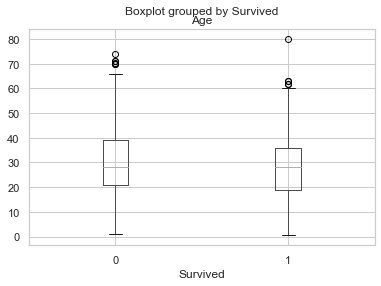

In [381]:
training_df.boxplot(column = 'Age', by= 'Survived')

In [382]:
survivors_df = training_df[training_df.Survived==1]
deaths_df = training_df[training_df.Survived==0]

In [383]:
survivors_df.Pclass.value_counts()

1    136
3    119
2     87
Name: Pclass, dtype: int64

In [384]:
deaths_df.Pclass.value_counts()

3    372
2     97
1     80
Name: Pclass, dtype: int64

In [385]:
survivors_df.Embarked.value_counts()

S    217
C     93
Q     30
Name: Embarked, dtype: int64

In [386]:
deaths_df.Embarked.value_counts()

S    427
C     75
Q     47
Name: Embarked, dtype: int64

<AxesSubplot:xlabel='Age', ylabel='Fare'>

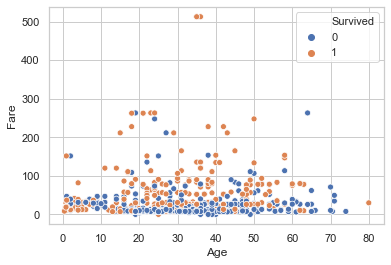

In [387]:
sns.scatterplot(x= 'Age', y='Fare', data= training_df, hue = 'Survived')

<AxesSubplot:xlabel='Age', ylabel='Pclass'>

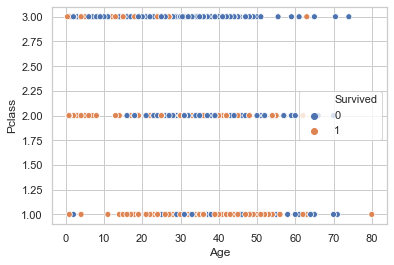

In [388]:
sns.scatterplot(x= 'Age', y='Pclass', data= training_df, hue = 'Survived')

<AxesSubplot:xlabel='Age', ylabel='Embarked'>

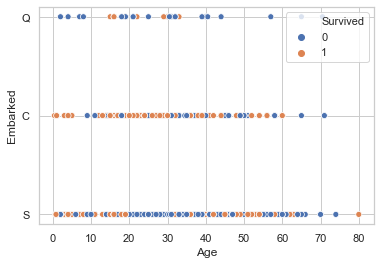

In [389]:
sns.scatterplot(x= 'Age', y='Embarked', data= training_df, hue = 'Survived')

<AxesSubplot:xlabel='Sex', ylabel='Fare'>

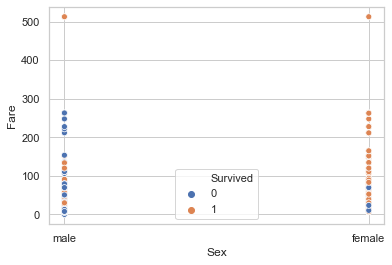

In [390]:
sns.scatterplot(x= 'Sex', y='Fare', data= training_df, hue = 'Survived')

<AxesSubplot:xlabel='Sex', ylabel='Age'>

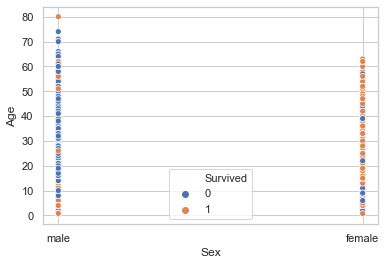

In [391]:
sns.scatterplot(x= 'Sex', y='Age', data= training_df, hue = 'Survived')

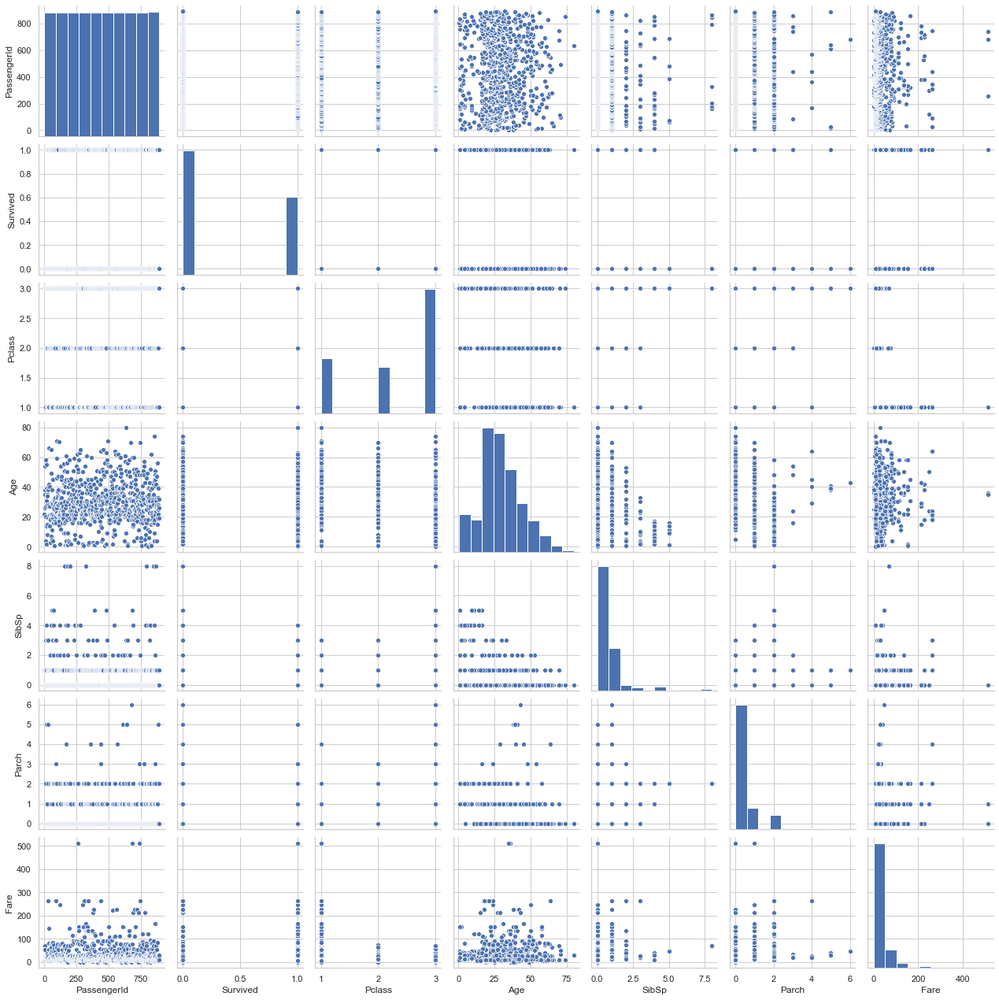

In [392]:
sns.pairplot(training_df)

In [393]:
training_df.isna().sum()

PassengerId      0
Survived         0
Pclass           0
Name             0
Sex              0
Age            177
SibSp            0
Parch            0
Ticket           0
Fare             0
Cabin          687
Embarked         2
dtype: int64

In [394]:
training_df["Cabin"]=training_df["Cabin"].fillna("U")
test_df["Cabin"]=test_df["Cabin"].fillna("U")
training_df["Cabin"]=training_df["Cabin"].map(lambda x: x[0])
test_df["Cabin"]=test_df["Cabin"].map(lambda x: x[0])

In [395]:
training_df.shape

(891, 12)

In [396]:
def cabin_assignment(dataset):
    dataset["Cabin A"]=np.where(dataset["Cabin"]=="A",1,0)
    dataset["Cabin B"]=np.where(dataset["Cabin"]=="B",1,0)
    dataset["Cabin C"]=np.where(dataset["Cabin"]=="C",1,0)
    dataset["Cabin D"]=np.where(dataset["Cabin"]=="D",1,0)
    dataset["Cabin E"]=np.where(dataset["Cabin"]=="E",1,0)
    dataset["Cabin F"]=np.where(dataset["Cabin"]=="F",1,0)
    dataset["Cabin G"]=np.where(dataset["Cabin"]=="G",1,0)
    dataset["Cabin T"]=np.where(dataset["Cabin"]=="T",1,0) 

In [397]:
cabin_assignment(training_df)
cabin_assignment(test_df)

In [398]:
training_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 891 entries, 0 to 890
Data columns (total 20 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   PassengerId  891 non-null    int64  
 1   Survived     891 non-null    int64  
 2   Pclass       891 non-null    int64  
 3   Name         891 non-null    object 
 4   Sex          891 non-null    object 
 5   Age          714 non-null    float64
 6   SibSp        891 non-null    int64  
 7   Parch        891 non-null    int64  
 8   Ticket       891 non-null    object 
 9   Fare         891 non-null    float64
 10  Cabin        891 non-null    object 
 11  Embarked     889 non-null    object 
 12  Cabin A      891 non-null    int64  
 13  Cabin B      891 non-null    int64  
 14  Cabin C      891 non-null    int64  
 15  Cabin D      891 non-null    int64  
 16  Cabin E      891 non-null    int64  
 17  Cabin F      891 non-null    int64  
 18  Cabin G      891 non-null    int64  
 19  Cabin T 

In [399]:
cat_variables = training_df[['Sex', 'Embarked']]
cat_dummies_training = pd.get_dummies(cat_variables, drop_first=True)
cat_dummies_training.head()

,Sex_male,Embarked_Q,Embarked_S
0,1,0,1
1,0,0,0
2,0,0,1
3,0,0,1
4,1,0,1


In [400]:
cat_variables = test_df[['Sex', 'Embarked']]
cat_dummies_test = pd.get_dummies(cat_variables, drop_first=True)
cat_dummies_test.head()

,Sex_male,Embarked_Q,Embarked_S
0,1,1,0
1,0,0,1
2,1,1,0
3,1,0,1
4,0,0,1


In [401]:
training_df = training_df.drop(['Sex', 'Embarked'], axis=1)
training_df = pd.concat([training_df, cat_dummies_training], axis=1)
training_df.head()

,PassengerId,Survived,Pclass,Name,Age,SibSp,Parch,Ticket,Fare,Cabin,...,Cabin B,Cabin C,Cabin D,Cabin E,Cabin F,Cabin G,Cabin T,Sex_male,Embarked_Q,Embarked_S
0,1,0,3,"Braund, Mr. Owen Harris",22.0,1,0,A/5 21171,7.2500,U,...,0,0,0,0,0,0,0,1,0,1
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",38.0,1,0,PC 17599,71.2833,C,...,0,1,0,0,0,0,0,0,0,0
2,3,1,3,"Heikkinen, Miss. Laina",26.0,0,0,STON/O2. 3101282,7.9250,U,...,0,0,0,0,0,0,0,0,0,1
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",35.0,1,0,113803,53.1000,C,...,0,1,0,0,0,0,0,0,0,1
4,5,0,3,"Allen, Mr. William Henry",35.0,0,0,373450,8.0500,U,...,0,0,0,0,0,0,0,1,0,1


In [402]:
test_df = test_df.drop(['Sex', 'Embarked'], axis=1)
test_df = pd.concat([test_df, cat_dummies_test], axis=1)
test_df.head()

,PassengerId,Pclass,Name,Age,SibSp,Parch,Ticket,Fare,Cabin,Cabin A,Cabin B,Cabin C,Cabin D,Cabin E,Cabin F,Cabin G,Cabin T,Sex_male,Embarked_Q,Embarked_S
0,892,3,"Kelly, Mr. James",34.5,0,0,330911,7.8292,U,0,0,0,0,0,0,0,0,1,1,0
1,893,3,"Wilkes, Mrs. James (Ellen Needs)",47.0,1,0,363272,7.0000,U,0,0,0,0,0,0,0,0,0,0,1
2,894,2,"Myles, Mr. Thomas Francis",62.0,0,0,240276,9.6875,U,0,0,0,0,0,0,0,0,1,1,0
3,895,3,"Wirz, Mr. Albert",27.0,0,0,315154,8.6625,U,0,0,0,0,0,0,0,0,1,0,1
4,896,3,"Hirvonen, Mrs. Alexander (Helga E Lindqvist)",22.0,1,1,3101298,12.2875,U,0,0,0,0,0,0,0,0,0,0,1


In [403]:
training_df1 = training_df.drop(['PassengerId', 'Name', 
              'Ticket', 'Cabin'], axis=1)


In [404]:
test_df1 = test_df.drop(['Name', 
              'Ticket', 'Cabin'], axis=1)

In [405]:
training_df1.isna().sum()

Survived        0
Pclass          0
Age           177
SibSp           0
Parch           0
Fare            0
Cabin A         0
Cabin B         0
Cabin C         0
Cabin D         0
Cabin E         0
Cabin F         0
Cabin G         0
Cabin T         0
Sex_male        0
Embarked_Q      0
Embarked_S      0
dtype: int64

In [406]:
test_df1.isna().sum()

PassengerId     0
Pclass          0
Age            86
SibSp           0
Parch           0
Fare            1
Cabin A         0
Cabin B         0
Cabin C         0
Cabin D         0
Cabin E         0
Cabin F         0
Cabin G         0
Cabin T         0
Sex_male        0
Embarked_Q      0
Embarked_S      0
dtype: int64

In [407]:
imputer = KNNImputer(n_neighbors=29)
training_df2 = pd.DataFrame(imputer.fit_transform(training_df1),columns = training_df1.columns)
training_df2.head()

,Survived,Pclass,Age,SibSp,Parch,Fare,Cabin A,Cabin B,Cabin C,Cabin D,Cabin E,Cabin F,Cabin G,Cabin T,Sex_male,Embarked_Q,Embarked_S
0,0.0,3.0,22.0,1.0,0.0,7.2500,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0
1,1.0,1.0,38.0,1.0,0.0,71.2833,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,1.0,3.0,26.0,0.0,0.0,7.9250,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,1.0,1.0,35.0,1.0,0.0,53.1000,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,0.0,3.0,35.0,0.0,0.0,8.0500,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0


In [408]:
imputer = KNNImputer(n_neighbors=29)
test_df2 = pd.DataFrame(imputer.fit_transform(test_df1),columns = test_df1.columns)
test_df2.head()

,PassengerId,Pclass,Age,SibSp,Parch,Fare,Cabin A,Cabin B,Cabin C,Cabin D,Cabin E,Cabin F,Cabin G,Cabin T,Sex_male,Embarked_Q,Embarked_S
0,892.0,3.0,34.5,0.0,0.0,7.8292,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0
1,893.0,3.0,47.0,1.0,0.0,7.0000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,894.0,2.0,62.0,0.0,0.0,9.6875,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0
3,895.0,3.0,27.0,0.0,0.0,8.6625,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0
4,896.0,3.0,22.0,1.0,1.0,12.2875,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [409]:
training_df2.isna().sum()

Survived      0
Pclass        0
Age           0
SibSp         0
Parch         0
Fare          0
Cabin A       0
Cabin B       0
Cabin C       0
Cabin D       0
Cabin E       0
Cabin F       0
Cabin G       0
Cabin T       0
Sex_male      0
Embarked_Q    0
Embarked_S    0
dtype: int64

In [410]:
test_df2.isna().sum()

PassengerId    0
Pclass         0
Age            0
SibSp          0
Parch          0
Fare           0
Cabin A        0
Cabin B        0
Cabin C        0
Cabin D        0
Cabin E        0
Cabin F        0
Cabin G        0
Cabin T        0
Sex_male       0
Embarked_Q     0
Embarked_S     0
dtype: int64

<AxesSubplot:>

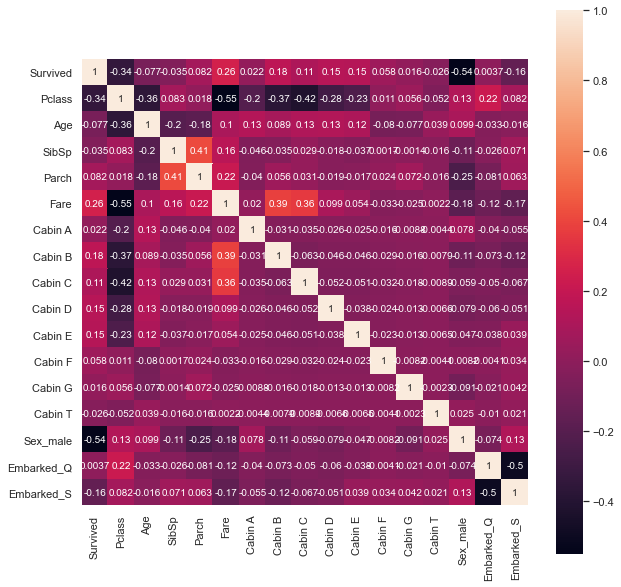

In [411]:
f,ax = plt.subplots(figsize=(10, 10))
corr = training_df2.corr()
sns.heatmap(corr, annot = True, square = True)


<AxesSubplot:xlabel='Age'>

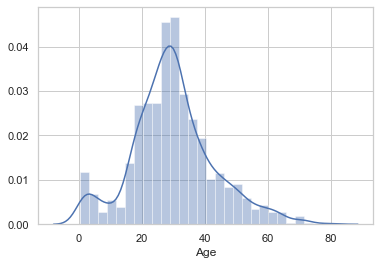

In [412]:
sns.distplot(training_df2['Age'])

In [413]:
x=training_df2.drop(["Survived"],axis=1)
y=training_df2["Survived"]
print(x.shape, y.shape)

(891, 16) (891,)


In [414]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.2,random_state=0)

In [415]:
print(x_train.shape, x_test.shape)

(712, 16) (179, 16)


In [416]:
k_fold = KFold(n_splits=5, shuffle=True, random_state=0)

LOGISTICAL REGRESSION

In [417]:
log_reg=LogisticRegression()
log_reg.fit(x_train,y_train)

print("Accuracy: " + str(acc_score(log_reg)))
confusion_matrix_model(log_reg)

Accuracy: 0.8006205062543092


,Predicted Dead,Predicted Survived
Actual Dead,0.85,0.15
Actual Survived,0.26,0.74


In [418]:
print(log_reg.coef_)

[[-7.36272345e-01 -4.27931680e-02 -3.38214593e-01 -3.48809933e-02
   3.93157307e-03  7.60328475e-01  3.70423667e-01 -7.93844418e-02
   9.92886863e-01  1.80164617e+00  7.14252082e-01  1.35954812e-03
  -8.20960355e-02 -2.48898903e+00  4.76376246e-01 -1.94164664e-01]]


In [419]:
[math.exp(x) for x in log_reg.coef_[0]]

[0.47889575065423057,
 0.9581095373223004,
 0.7130422575927353,
 0.965720336581694,
 1.0039393118416984,
 2.1389787054136575,
 1.4483481016642703,
 0.9236847531489857,
 2.6990149225237183,
 6.059614387632692,
 2.0426583707471604,
 1.0013604727269303,
 0.921183488138425,
 0.08299382831779067,
 1.6102287440387502,
 0.8235222889352983]

In [420]:
print(log_reg.intercept_)

[3.98870084]


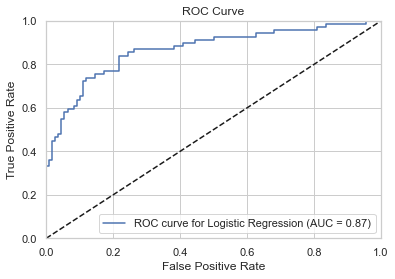

In [421]:
plt_roc_curve("Logistic Regression",log_reg,has_proba=True)

<AxesSubplot:title={'center':'Normalized Confusion Matrix'}, xlabel='Predicted label', ylabel='True label'>

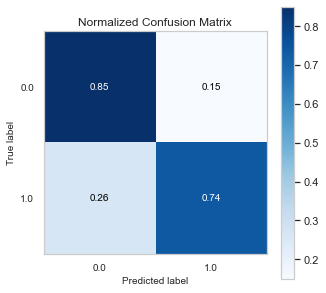

In [422]:
skplt.metrics.plot_confusion_matrix(y_test, log_reg.predict(x_test),normalize=True, figsize=(5,5))

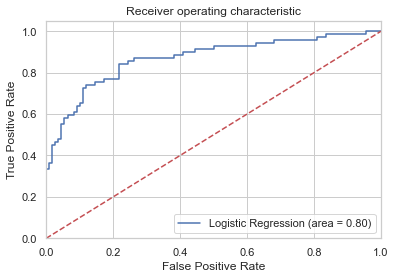

In [423]:
logit_roc_auc = roc_auc_score(y_test, log_reg.predict(x_test))
fpr, tpr, thresholds = roc_curve(y_test, log_reg.predict_proba(x_test)[:,1])
plt.figure()
plt.plot(fpr, tpr, label='Logistic Regression (area = %0.2f)' % logit_roc_auc)
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")
plt.savefig('Log_ROC')
plt.show()

SUPPORT VECTOR MACHINE

In [424]:
SVC_rbf=SVC(kernel="rbf")
SVC_rbf.fit(x_train,y_train)

print("Accuracy: " + str(acc_score(SVC_rbf)))
confusion_matrix_model(SVC_rbf)

Accuracy: 0.6614695163990938


,Predicted Dead,Predicted Survived
Actual Dead,0.95,0.05
Actual Survived,0.64,0.36


<AxesSubplot:title={'center':'Normalized Confusion Matrix'}, xlabel='Predicted label', ylabel='True label'>

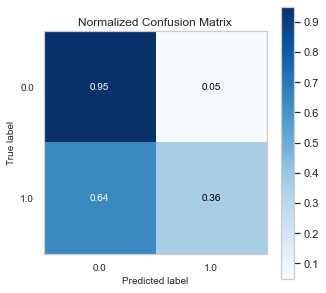

In [425]:
skplt.metrics.plot_confusion_matrix(y_test, SVC_rbf.predict(x_test),normalize=True, figsize=(5,5))

K-NEAREST NEIGHBORS

In [426]:
KNN=KNeighborsClassifier(n_neighbors=29)
KNN.fit(x_train,y_train)

print("Accuracy: " + str(acc_score(KNN)))
confusion_matrix_model(KNN)

Accuracy: 0.6811188811188812


,Predicted Dead,Predicted Survived
Actual Dead,0.90,0.10
Actual Survived,0.46,0.54


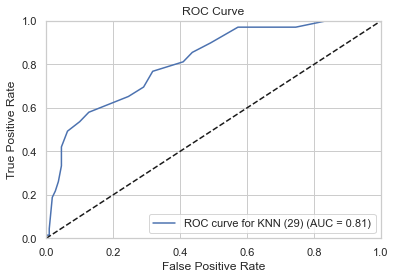

In [427]:
plt_roc_curve("KNN (29)",KNN,has_proba=True)

<AxesSubplot:title={'center':'Normalized Confusion Matrix'}, xlabel='Predicted label', ylabel='True label'>

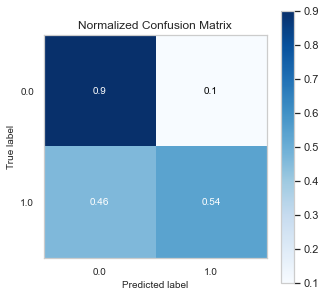

In [428]:
skplt.metrics.plot_confusion_matrix(y_test, KNN.predict(x_test),normalize=True, figsize=(5,5))

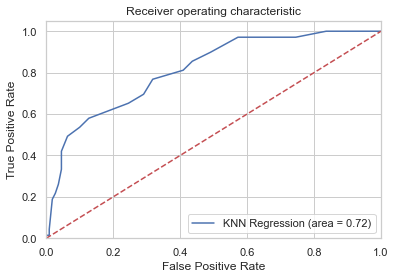

In [429]:
KNN_roc_auc = roc_auc_score(y_test, KNN.predict(x_test))
fpr, tpr, thresholds = roc_curve(y_test, KNN.predict_proba(x_test)[:,1])
plt.figure()
plt.plot(fpr, tpr, label='KNN Regression (area = %0.2f)' % KNN_roc_auc)
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")
plt.savefig('KNN_ROC')
plt.show()

In [430]:
Classifiers=["Logistic Regression","Support Vector Machine","K-Nearest Neighbors"]
Acc=[acc_score(x) for x in [log_reg,SVC_rbf,KNN]]
auc_scores_prob=[aucscore(x,has_proba=True) for x in [log_reg,KNN]]
auc_scores_noprob=[aucscore(x,has_proba=False) for x in [SVC_rbf]]
auc_scores=auc_scores_prob[:3] + auc_scores_noprob + auc_scores_prob[3:]
cols=["Classifier","Accuracy","AUC"]
results = pd.DataFrame(columns=cols)
results["Classifier"]=Classifiers
results["Accuracy"]=Acc
results["AUC"]=auc_scores
results


,Classifier,Accuracy,AUC
0,Logistic Regression,0.800621,0.866930
1,Support Vector Machine,0.661470,0.813307
2,K-Nearest Neighbors,0.681119,0.798155


GRID SEARCH FOR LOGISTIC REGRESSION MODEL

In [431]:
parameters = {"class_weight": ["None", "balanced"], 
              "max_iter": [25,50,75,100],
              "penalty": ["l1", "l2", "elasticnet", "none"], 
              "solver": ["newton-cg", "lbfgs", "liblinear", "sag", "saga"]
             }

In [432]:
grid_cv = GridSearchCV(log_reg, parameters, scoring = make_scorer(accuracy_score))
grid_cv = grid_cv.fit(x_train, y_train)

In [433]:
print("Our optimized Logistic Regression model is:")
grid_cv.best_estimator_

Our optimized Logistic Regression model is:


LogisticRegression(C=1.0, class_weight='None', dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=25,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='newton-cg', tol=0.0001, verbose=0,
                   warm_start=False)

In [434]:
logreg_tuned = LogisticRegression(C=1.0, class_weight='None', dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=75,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)
logreg_tuned.fit(x_train, y_train)

LogisticRegression(C=1.0, class_weight='None', dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=75,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)

In [435]:
print("Accuracy: " + str(acc_score(logreg_tuned)))
confusion_matrix_model(logreg_tuned)

Accuracy: 0.7978233034571063


,Predicted Dead,Predicted Survived
Actual Dead,0.85,0.15
Actual Survived,0.28,0.72


RANDOM FOREST

In [436]:
Randreg = RandomForestClassifier()

# Fit data on to the model
Randreg.fit(x_train, y_train)

# Predict
y_predicted_Randreg = Randreg.predict(x_test)

In [437]:
print("Accuracy: " + str(acc_score(Randreg)))
confusion_matrix_model(Randreg)

Accuracy: 0.8077120063035557


,Predicted Dead,Predicted Survived
Actual Dead,0.94,0.06
Actual Survived,0.32,0.68


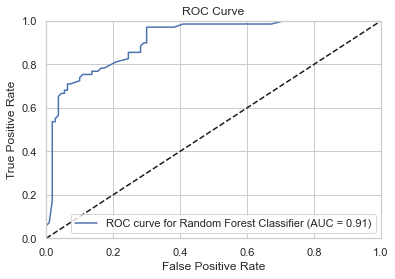

In [438]:
plt_roc_curve("Random Forest Classifier",Randreg,has_proba=True)

<AxesSubplot:title={'center':'Normalized Confusion Matrix'}, xlabel='Predicted label', ylabel='True label'>

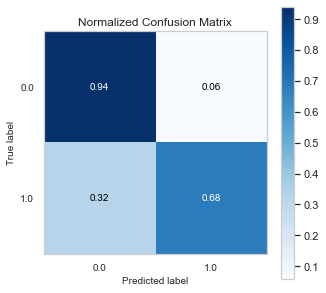

In [439]:
skplt.metrics.plot_confusion_matrix(y_test, Randreg.predict(x_test),normalize=True, figsize=(5,5))

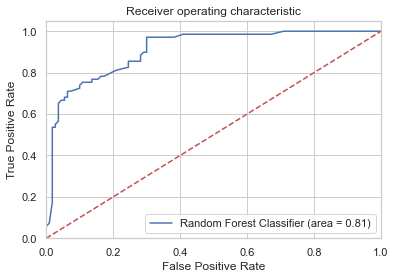

In [440]:
RF_roc_auc = roc_auc_score(y_test, Randreg.predict(x_test))
fpr, tpr, thresholds = roc_curve(y_test, Randreg.predict_proba(x_test)[:,1])
plt.figure()
plt.plot(fpr, tpr, label='Random Forest Classifier (area = %0.2f)' % RF_roc_auc)
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")
plt.savefig('RF_ROC')
plt.show()

EXTRA-TREES

In [441]:
ETclass = ExtraTreesClassifier()

# Fit data on to the model
ETclass.fit(x_train, y_train)

# Predict
y_predicted_ETclass = ETclass.predict(x_test)

In [442]:
print("Accuracy: " + str(acc_score(ETclass)))
ETacc=acc_score(ETclass)
confusion_matrix_model(ETclass)

Accuracy: 0.7739485866246429


,Predicted Dead,Predicted Survived
Actual Dead,0.89,0.11
Actual Survived,0.33,0.67


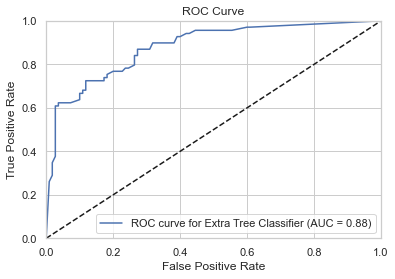

In [443]:
plt_roc_curve("Extra Tree Classifier",ETclass,has_proba=True)

<AxesSubplot:title={'center':'Normalized Confusion Matrix'}, xlabel='Predicted label', ylabel='True label'>

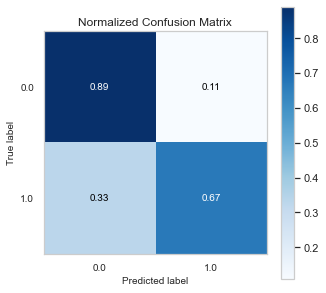

In [444]:
skplt.metrics.plot_confusion_matrix(y_test, ETclass.predict(x_test),normalize=True, figsize=(5,5))

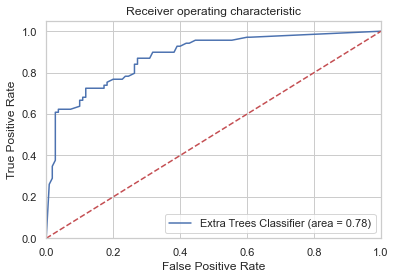

In [445]:
ET_roc_auc = roc_auc_score(y_test, ETclass.predict(x_test))
fpr, tpr, thresholds = roc_curve(y_test, ETclass.predict_proba(x_test)[:,1])
plt.figure()
plt.plot(fpr, tpr, label='Extra Trees Classifier (area = %0.2f)' % ET_roc_auc)
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")
plt.savefig('ET_ROC')
plt.show()

In [446]:
feat_names = x.columns
tree_chart(ETreg, feat_names, 'etreg_tree')

# Display in jupyter notebook
Image(filename = 'etreg_tree.png')

GRADIENT BOOSTING

In [447]:
gbrt = GradientBoostingClassifier(max_depth=2, n_estimators=120)
gbrt.fit(x_train, y_train)

errors = [mean_squared_error(y_test, y_pred)
          for y_pred in gbrt.staged_predict(x_test)]
bst_n_estimators = np.argmin(errors) + 1

gbrt_best = GradientBoostingClassifier(max_depth=2,n_estimators=bst_n_estimators)
gbrt_best.fit(x_train, y_train)


GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=2,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=32,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=None, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)

In [448]:
print("Accuracy: " + str(acc_score(gbrt_best)))
GBacc=acc_score(gbrt_best)
confusion_matrix_model(gbrt_best)

Accuracy: 0.8090712104796612


,Predicted Dead,Predicted Survived
Actual Dead,0.93,0.07
Actual Survived,0.32,0.68


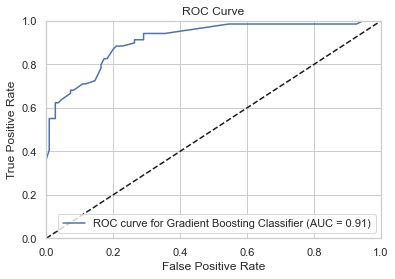

In [449]:
plt_roc_curve("Gradient Boosting Classifier",gbrt_best,has_proba=True)

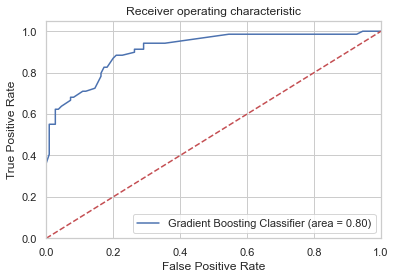

In [450]:
GB_roc_auc = roc_auc_score(y_test, gbrt_best.predict(x_test))
fpr, tpr, thresholds = roc_curve(y_test, gbrt_best.predict_proba(x_test)[:,1])
plt.figure()
plt.plot(fpr, tpr, label='Gradient Boosting Classifier (area = %0.2f)' % GB_roc_auc)
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")
plt.savefig('GB_ROC')
plt.show()

In [451]:
Classifiers=["Tuned Logistic Regression","Random Forest Classifier","Extra Trees Classifier", "Gradient Boosting"]
Acc=[acc_score(x) for x in [logreg_tuned,Randreg,ETreg, gbrt_best]]
auc_scores_prob=[aucscore(x,has_proba=True) for x in [logreg_tuned,Randreg, ETreg, gbrt_best]]
auc_scores=auc_scores_prob[:3] + auc_scores_prob[3:]
cols=["Classifier","Accuracy","AUC"]
results = pd.DataFrame(columns=cols)
results["Classifier"]=Classifiers
results["Accuracy"]=Acc
results["AUC"]=auc_scores
results

,Classifier,Accuracy,AUC
0,Tuned Logistic Regression,0.797823,0.865086
1,Random Forest Classifier,0.800680,0.910474
2,Extra Trees Classifier,0.778174,0.881555
3,Gradient Boosting,0.809071,0.912055


In [452]:
predict_df = test_df2.copy()

del predict_df['PassengerId']

result = gbrt_best.predict(predict_df).astype(np.int)

submit_df = pd.DataFrame(test_df["PassengerId"])

submit_df["Survived"] = result

submit_df

,PassengerId,Survived
0,892,0
1,893,0
2,894,0
3,895,0
4,896,1
...,...,...
413,1305,0
414,1306,1
415,1307,0
416,1308,0


In [453]:
submit_df.to_csv('./GB_prediction1.csv', columns=['PassengerId','Survived'], index=False)

In [454]:
predict_df1 = test_df2.copy()

del predict_df1['PassengerId']

result1 = Randreg.predict(predict_df1).astype(np.int)

submit_df1 = pd.DataFrame(test_df["PassengerId"])

submit_df1["Survived"] = result1

submit_df1

,PassengerId,Survived
0,892,0
1,893,0
2,894,0
3,895,1
4,896,0
...,...,...
413,1305,0
414,1306,1
415,1307,0
416,1308,0


In [455]:
submit_df.to_csv('./RF_prediction.csv', columns=['PassengerId','Survived'], index=False)